In [1]:
# import basic functionality / libs
import sys
import os
import numpy as np
import pandas as pd
import json
import scipy

%matplotlib inline

sys.path.append('../../')
# import fragility related modules
from edm.fragility.model.impulsemodel import ImpulseModel
from edm.fragility.model.fragilitymodel import FragilityModel
from edm.base.utils.data_structures_utils import stabilize_matrix
from edp.loaders.results.frag import ResultFrag
from edp.loaders.results.mvar import ResultLTV

import edv
from edv.plot_fragility_heatmap import PlotFragilityHeatmap
from edv.baseplot import BasePlotter

# import basic plotting
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

# Import magic commands for jupyter notebook 
# - autoreloading a module
# - profiling functions for memory usage and scripts
%load_ext autoreload
%autoreload 2

In [2]:
def reject_outliers(data, m=1.5):
    ceil_val = np.mean(data.ravel())*m
    outlier_val = np.mean(data) + np.std(data)*m
    
    inds = np.where(data > outlier_val)
    newdata = data.copy()
    newdata[inds] = ceil_val
    return newdata

def reject_outliers_median(data, m=5):
    ceil_val = np.median(data.ravel())*m
    outlier_val = np.median(data) + np.std(data)*m
    
    inds = np.where(data > outlier_val)
    newdata = data.copy()
    newdata[inds] = ceil_val
    return newdata

In [3]:
patient = 'pt1'

figdir = '/home/adam2392/Downloads/figures/summary/'
# figdir = '/Users/adam2392/Documents/figures/summary/'
figdir = os.path.join(figdir, patient)
if not os.path.exists(figdir):
    os.makedirs(figdir)

In [4]:
# patient = 'la01'
patient = 'pt1'

# resultsdir = os.path.join('/Users/adam2392/Downloads/output_new/fragility/monopolar/ieeg/nih/')
resultsdir = os.path.join('/home/adam2392/hdd/data/processed/output_new/fragility/monopolar/ieeg/nih/')

resultfrag = ResultFrag(results_dir=resultsdir,
                        preload=False)

jsonfilepaths = resultfrag.jsonfilepaths

print(jsonfilepaths)

['pt1_ii_1_frag.json', 'pt1_ii_2_frag.json', 'pt1_sz_2_frag.json', 'pt1_sz_3_frag.json', 'pt1_sz_4_frag.json', 'pt1_sz_6_frag.json', 'pt2_ii_1_frag.json', 'pt2_ii_2_frag.json', 'pt2_sz_1_frag.json', 'pt2_sz_3_frag.json', 'pt2_sz_4_frag.json', 'pt3_ii_1_frag.json', 'pt3_ii_2_frag.json', 'pt3_sz_2_frag.json', 'pt3_sz_4_frag.json', 'pt6_sz_3_frag.json', 'pt6_sz_4_frag.json', 'pt6_sz_5_frag.json', 'pt7_sz_19_frag.json', 'pt7_sz_21_frag.json', 'pt7_sz_22_frag.json', 'pt8_sz_1_frag.json', 'pt8_sz_2_frag.json', 'pt8_sz_3_frag.json', 'pt10_sz_1_frag.json', 'pt10_sz_2_frag.json', 'pt10_sz_3_frag.json', 'pt11_sz_1_frag.json', 'pt11_sz_2_frag.json', 'pt11_sz_3_frag.json', 'pt11_sz_4_frag.json', 'pt12_sz_1_frag.json', 'pt12_sz_2_frag.json', 'pt13_sz_1_frag.json', 'pt13_sz_2_frag.json', 'pt13_sz_3_frag.json', 'pt13_sz_5_frag.json', 'pt14_sz_1_frag.json', 'pt14_sz_2_frag.json', 'pt14_sz_3_frag.json', 'pt15_sz_1_frag.json', 'pt15_sz_2_frag.json', 'pt15_sz_3_frag.json', 'pt15_sz_4_frag.json', 'pt16_sz

In [5]:
fragmodel = resultfrag.loadpipeline(jsonfilepath=jsonfilepaths[4])

Error in extracting metadata:  'modality'


In [6]:
chanlabels = np.array(fragmodel.chanlabels)
ezcontacts = np.array(fragmodel.get_metadata()['clinezelecs'])
szonset = fragmodel.onsetwin
szoffset = fragmodel.offsetwin

dataset_id = fragmodel.dataset_id
patient_id = fragmodel.patient_id

metadata = fragmodel.get_metadata()

# Run Impulse Model

In [7]:
adjmats = fragmodel.ltvmodel.get_data()

print(adjmats.shape)

(2967, 86, 86)


In [41]:
impulsemodel = ImpulseModel(N=100)

print(impulsemodel)

In [43]:
frag_inf, frag_1, frag_2 = impulsemodel.apply_impulse_lti(adjmats[0,...])

In [47]:
from sklearn.preprocessing import StandardScaler

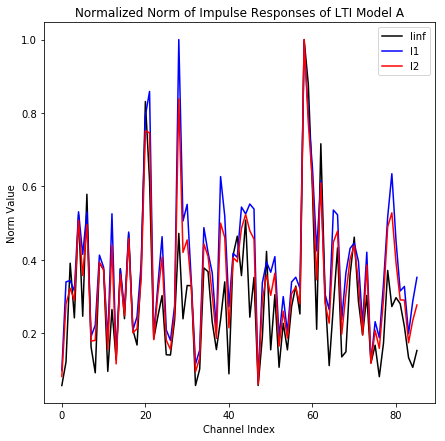

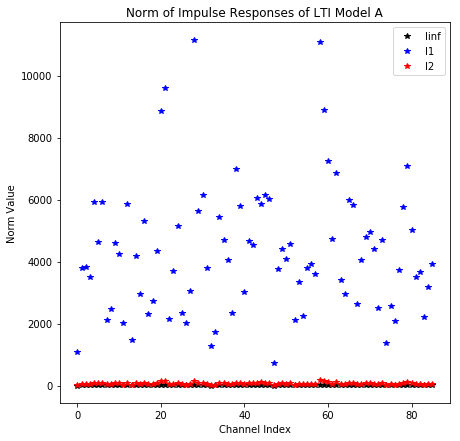

In [51]:
plt.figure(figsize=(7,7))
plt.plot(frag_inf / np.max(frag_inf), 'k-', label='linf')
plt.plot(frag_1 / np.max(frag_1), 'b-', label='l1')
plt.plot(frag_2 / np.max(frag_2), 'r-', label='l2')
plt.title("Normalized Norm of Impulse Responses of LTI Model A")
plt.xlabel("Channel Index")
plt.ylabel("Norm Value")
plt.legend()

plt.figure(figsize=(7,7))
plt.plot(frag_inf, 'k*', label='linf')
plt.plot(frag_1, 'b*', label='l1')
plt.plot(frag_2, 'r*', label='l2')
plt.title("Norm of Impulse Responses of LTI Model A")
plt.xlabel("Channel Index")
plt.ylabel("Norm Value")
plt.legend()

In [12]:
impulse_responses = impulsemodel.impulse_responses

print(len(impulse_responses))

86


In [13]:
plotter = BasePlotter(figdir)

../../edv/baseplot.py:141: UserWarning: Noninteractive matplotlib backend! No highlighting functionality in plots!
  "Noninteractive matplotlib backend! No highlighting functionality in plots!")


../../edv/baseplot.py:39: UserWarning: matplotlib.pyplot as already been imported, this call will have no effect.
  mp.use('TkAgg')


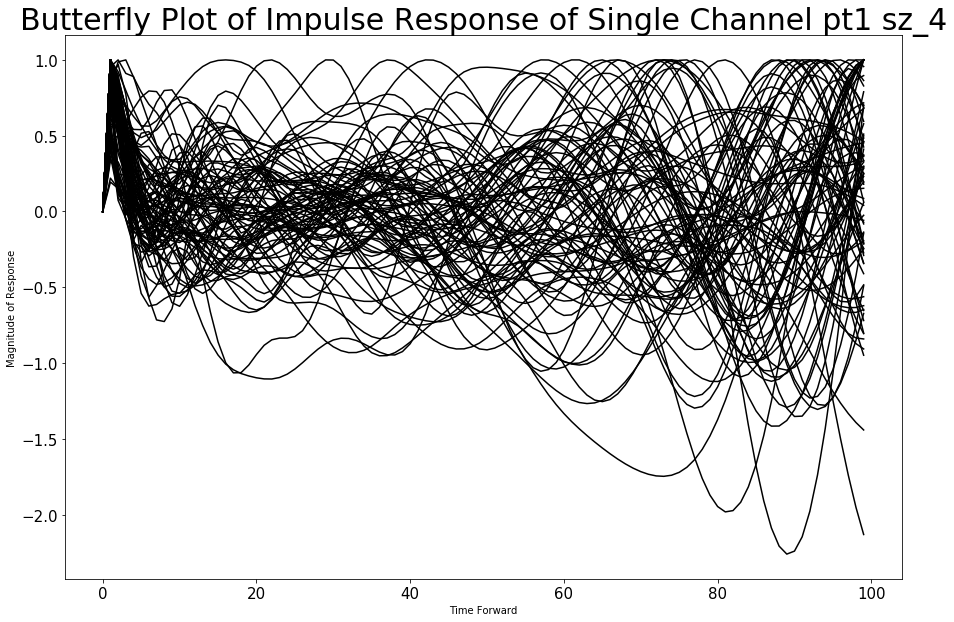

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f2dd2c35ac8>)

In [30]:
plotter.butterfly_plot(impulse_responses, 
                titlestr="Butterfly Plot of Impulse Response of Single Channel {} {}".format(patient_id, dataset_id),
                figure_name="{}_{}_bflyplot".format(patient_id, dataset_id))

In [17]:
print(len(impulse_responses))
print(impulse_responses[0].shape)

for idx, resp in enumerate(impulse_responses):
    impulse_responses[idx] = np.mean(resp, axis=0)

86
(100, 86)


../../edv/baseplot.py:331: RuntimeWarning: All-NaN slice encountered
  data[i, :] = data[i, :] / np.nanmax(data[i, :])
../../edv/baseplot.py:39: UserWarning: matplotlib.pyplot as already been imported, this call will have no effect.
  mp.use('TkAgg')


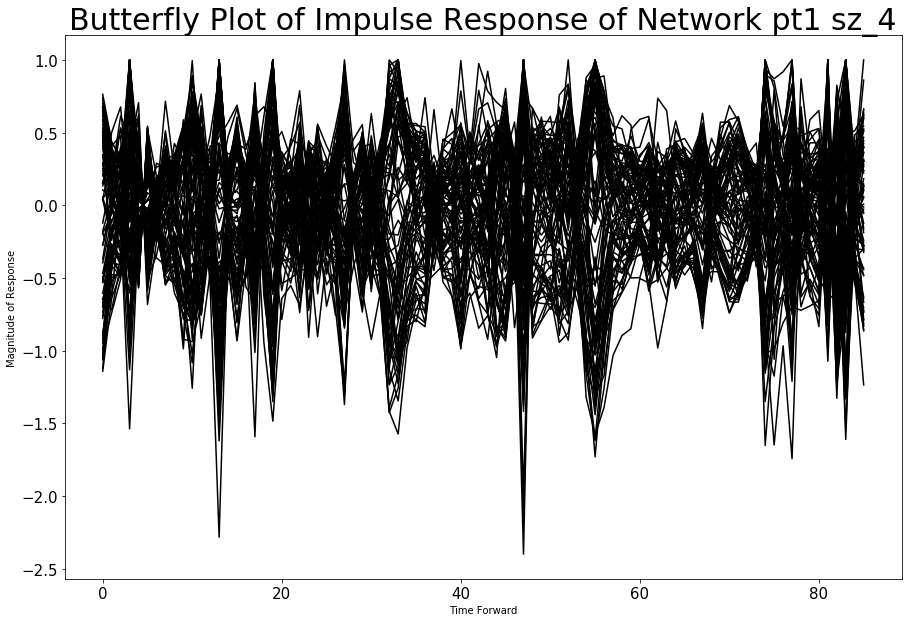

(<Figure size 1080x720 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fe907afa5c0>)

In [18]:
plotter.butterfly_plot(impulse_responses, 
                titlestr="Butterfly Plot of Impulse Response of Network {} {}".format(patient_id, dataset_id),
                figure_name="{}_{}_bflyplot_network".format(patient_id, dataset_id))

(100,)
done


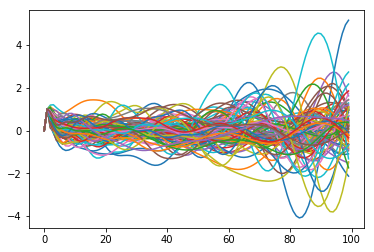

In [14]:
plt.figure()
for i in range(len(impulse_responses)):
    y = impulse_responses[i].data
    plt.plot(y)

print(y.shape)
print("done")

# Rerun Cortical Stimulation

11/9/18: This time taking the norm of the perturbed signal, rather then the norm over all signals.

In [10]:
# stabilize?
frag_inf, frag_1, frag_2 = impulsemodel.run(adjmats=adjmats)

100%|██████████| 2967/2967 [05:26<00:00,  9.57it/s]


In [11]:
np.savez_compressed("{}_{}_cortstim_vecnormnetworkresponse.npz".format(patient_id,
                                                                    dataset_id),
                    frag_inf=frag_inf,
                    frag_1=frag_1,
                    frag_2=frag_2,
                    metadata=metadata)

In [43]:
data = dict(np.load('pt1_sz4_cortstim_normchannelresponse.npz'))

print(data.keys())
frag_inf = data['frag_inf']
frag_1 = data['frag_1']
frag_2 = data['frag_2']

print(frag_inf.shape, frag_1.shape, frag_2.shape)

dict_keys(['frag_inf', 'frag_1', 'frag_2', 'metadata'])
(86, 2967) (86, 2967) (86, 2967)


# Vector Norm of Network Response

In [14]:
data = dict(np.load('pt1_sz_4_cortstim_vecnormnetworkresponse.npz'))

print(data.keys())
frag_inf = data['frag_inf']
frag_1 = data['frag_1']
frag_2 = data['frag_2']

print(frag_inf.shape, frag_1.shape, frag_2.shape)

dict_keys(['frag_inf', 'frag_1', 'frag_2', 'metadata'])
(86, 2967) (86, 2967) (86, 2967)


In [15]:
plotter = PlotFragilityHeatmap(figdir)

../../edv/baseplot.py:141: UserWarning: Noninteractive matplotlib backend! No highlighting functionality in plots!
  "Noninteractive matplotlib backend! No highlighting functionality in plots!")
../../edv/plot_fragility_heatmap.py:40: UserWarning: Noninteractive matplotlib backend! No highlighting functionality in plots!
  "Noninteractive matplotlib backend! No highlighting functionality in plots!")


In [25]:
# frag_1 = reject_outliers(frag_1, m=0.01)
# frag_2 = reject_outliers(frag_2, m=0.01)
# frag_inf = reject_outliers(frag_inf, m=0.01)

frag_1 = reject_outliers_median(frag_1, m=0.01)
frag_2 = reject_outliers_median(frag_2, m=0.01)
frag_inf = reject_outliers_median(frag_inf, m=0.01)

In [26]:
print(frag_1.shape)
print(frag_2.shape)

(86, 2967)
(86, 2967)


27.71758938853923
24.08285331868253
20.663923010684233


Text(0.5, 1.0, 'Linf Network Norm Distribution')

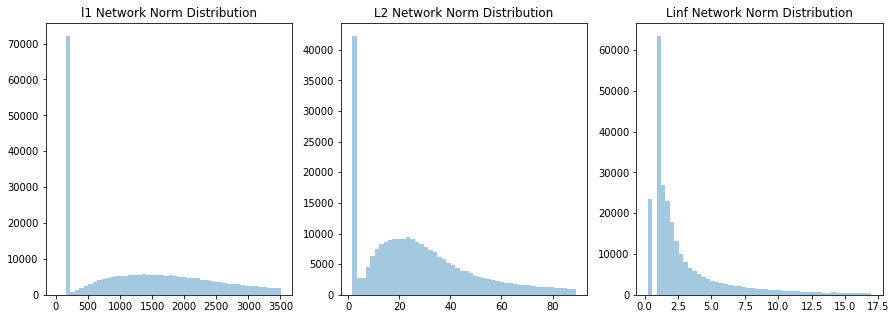

In [27]:
print(np.mean(frag_2))
print(np.median(frag_2))
print(np.std(frag_2))

plt.figure(figsize=(15,5))
plt.subplot(131)
sns.distplot(frag_1.ravel(), kde=False)
plt.title("l1 Network Norm Distribution")

plt.subplot(132)
sns.distplot(frag_2.ravel(), kde=False)
plt.title("L2 Network Norm Distribution")

plt.subplot(133)
sns.distplot(frag_inf.ravel(), kde=False)
plt.title("Linf Network Norm Distribution")

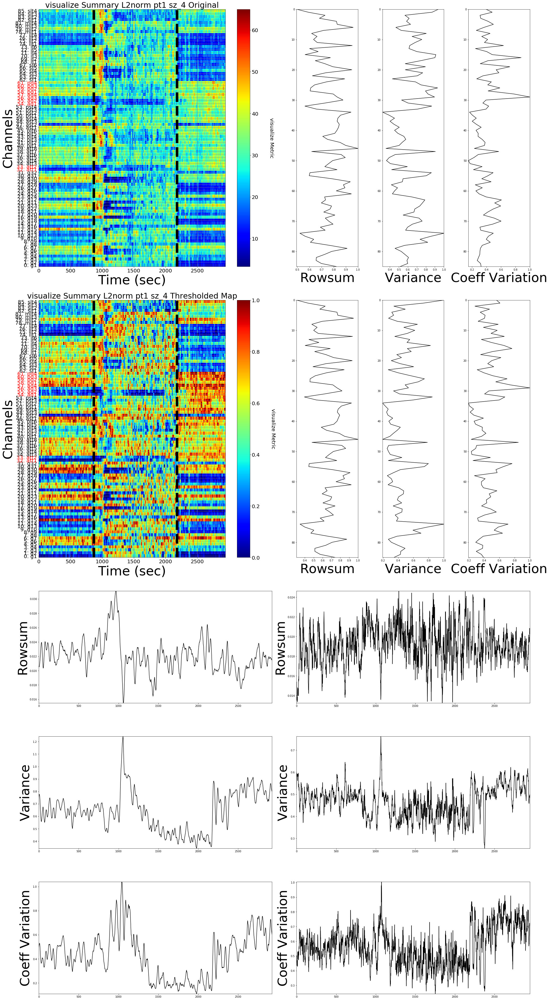

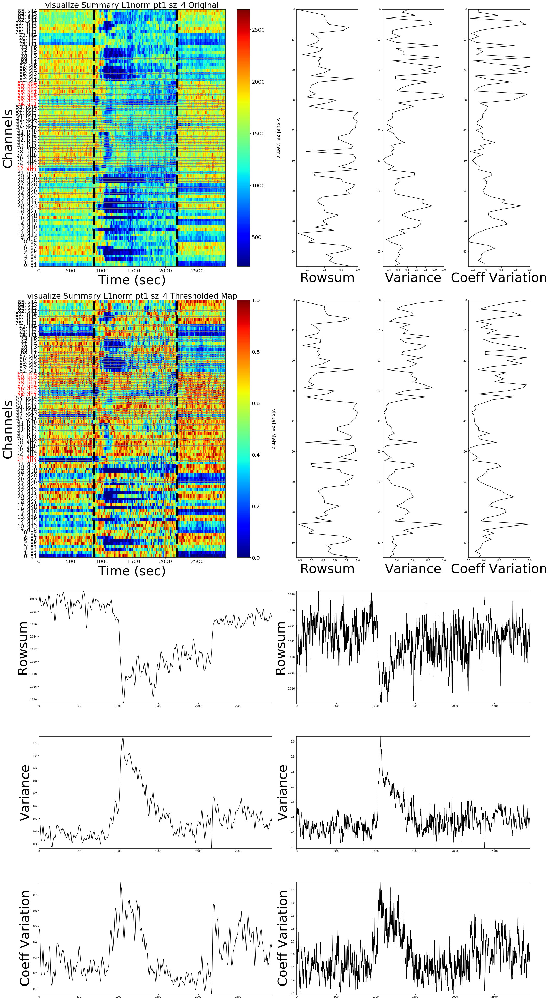

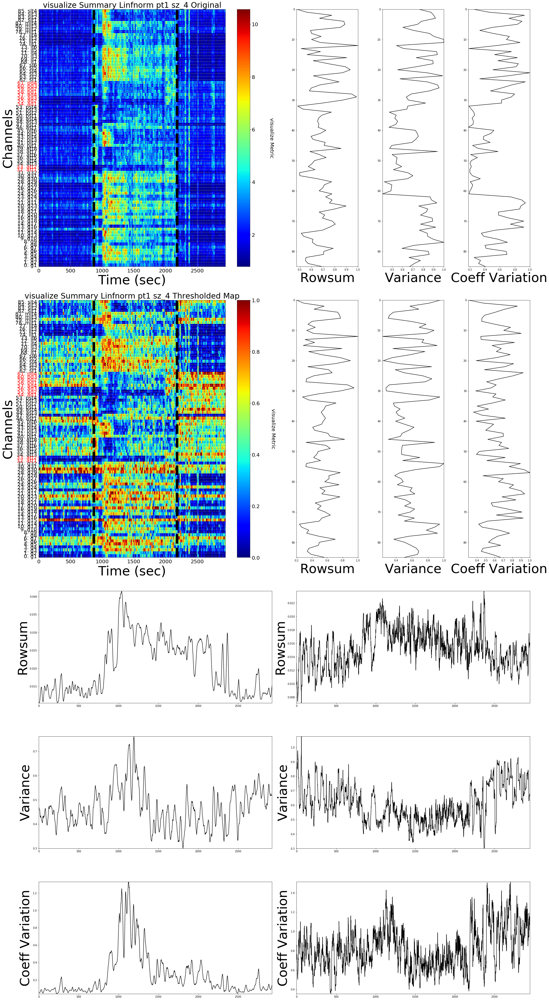

In [29]:
vertlines = [szonset, szoffset]

# plot summary plot for impulse repsonse
plotter.satellite_summary(frag_2, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary L2norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_l2_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_1, labels=chanlabels, ezcontacts=ezcontacts, 
                          vertlines=vertlines,
                      titlestr="visualize Summary L1norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_l1_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_inf, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary Linfnorm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_linf_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))

# Vector Norm of Channel Response

In [32]:
data = dict(np.load('pt1_sz4_cortstim_normchannelresponse.npz'))

print(data.keys())
frag_inf = data['frag_inf']
frag_1 = data['frag_1']
frag_2 = data['frag_2']

print(frag_inf.shape, frag_1.shape, frag_2.shape)

dict_keys(['frag_inf', 'frag_1', 'frag_2', 'metadata'])
(86, 2967) (86, 2967) (86, 2967)


In [33]:
plotter = PlotFragilityHeatmap(figdir)

../../edv/baseplot.py:141: UserWarning: Noninteractive matplotlib backend! No highlighting functionality in plots!
  "Noninteractive matplotlib backend! No highlighting functionality in plots!")
../../edv/plot_fragility_heatmap.py:40: UserWarning: Noninteractive matplotlib backend! No highlighting functionality in plots!
  "Noninteractive matplotlib backend! No highlighting functionality in plots!")


In [37]:
# frag_1 = reject_outliers(frag_1, m=0.01)
# frag_2 = reject_outliers(frag_2, m=0.01)
# frag_inf = reject_outliers(frag_inf, m=0.01)

frag_1 = reject_outliers_median(frag_1, m=0.01)
frag_2 = reject_outliers_median(frag_2, m=0.01)
frag_inf = reject_outliers_median(frag_inf, m=0.01)

In [38]:
print(frag_1.shape)
print(frag_2.shape)

(86, 2967)
(86, 2967)


5.726475279614376
2.968961299196254
12.944943975836757


Text(0.5, 1.0, 'Linf Norm Distribution')

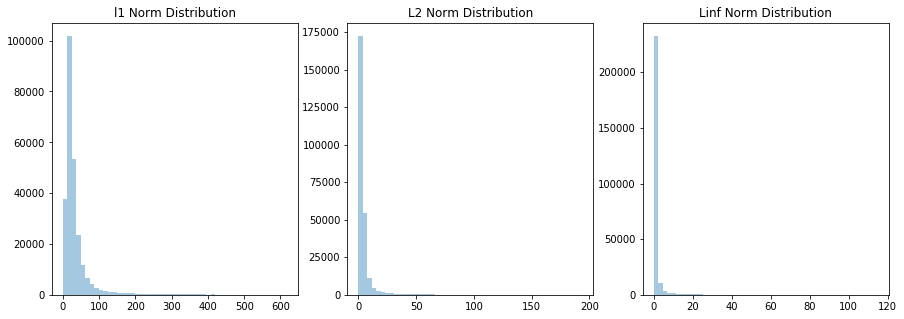

In [39]:
print(np.mean(frag_2))
print(np.median(frag_2))
print(np.std(frag_2))

plt.figure(figsize=(15,5))
plt.subplot(131)
sns.distplot(frag_1.ravel(), kde=False)
plt.title("l1 Norm Distribution")

plt.subplot(132)
sns.distplot(frag_2.ravel(), kde=False)
plt.title("L2 Norm Distribution")

plt.subplot(133)
sns.distplot(frag_inf.ravel(), kde=False)
plt.title("Linf Norm Distribution")

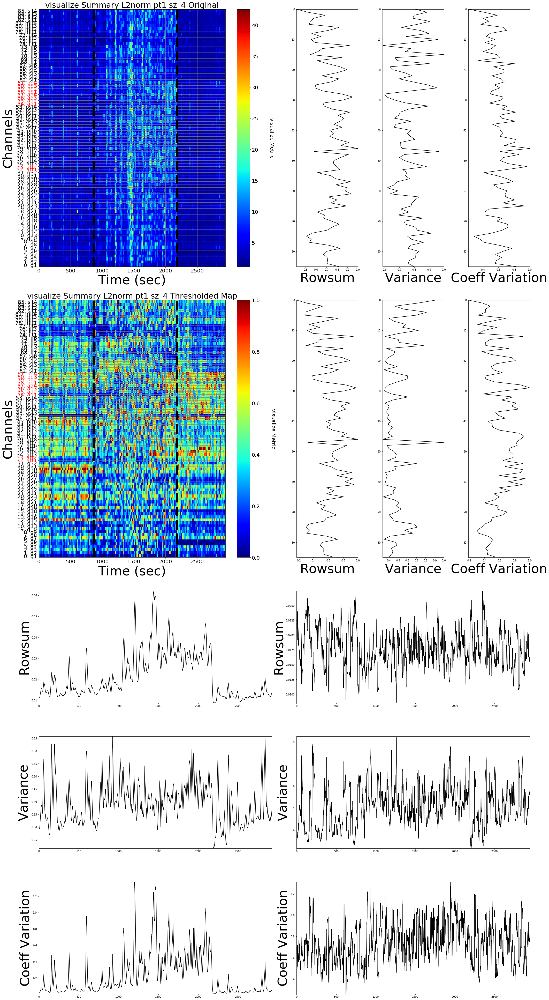

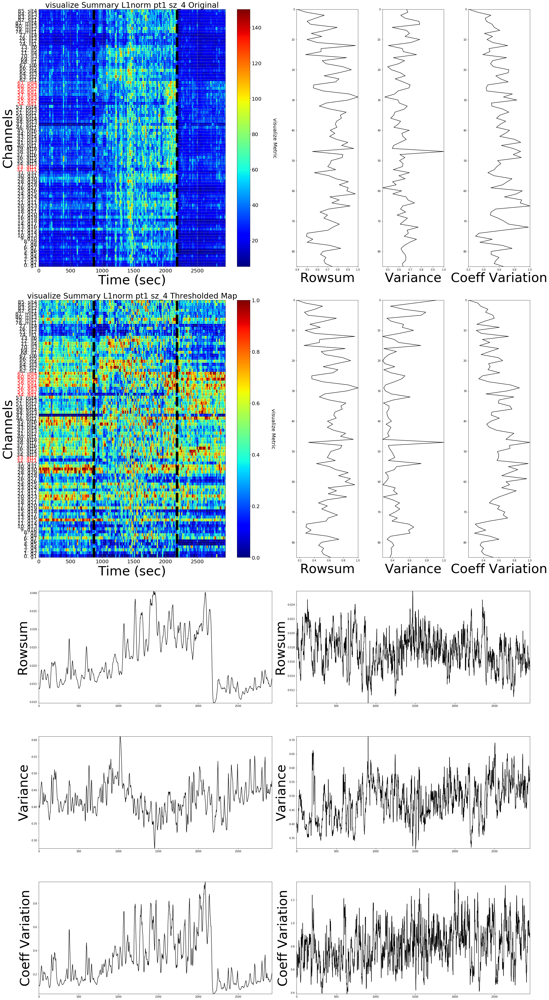

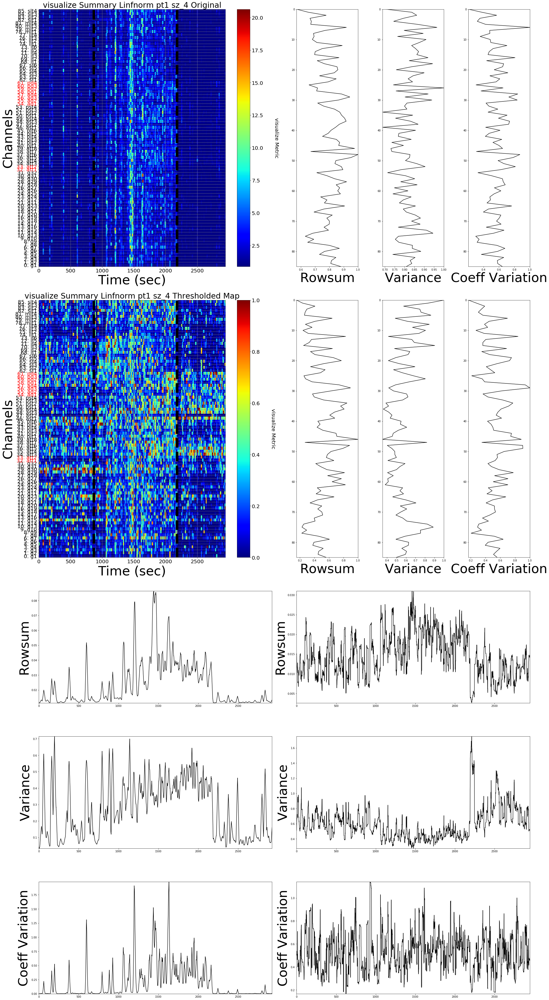

In [40]:
vertlines = [szonset, szoffset]

# plot summary plot for impulse repsonse
plotter.satellite_summary(frag_2, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary L2norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="impulse_l2_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_1, labels=chanlabels, ezcontacts=ezcontacts, 
                          vertlines=vertlines,
                      titlestr="visualize Summary L1norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="impulse_l1_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_inf, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary Linfnorm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="impulse_linf_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))

# Network Response

In [36]:
frag_1 = reject_outliers(frag_1, m=2)
frag_2 = reject_outliers(frag _2, m=2)
frag_inf = reject_outliers(frag_inf, m=2)

In [37]:
print(frag_1.shape)
print(frag_2.shape)

(86, 2967)
(86, 2967)


46.480346183750505
24.196597389424305
61.9783734888451


Text(0.5, 1.0, 'Inf-inf Norm Distribution')

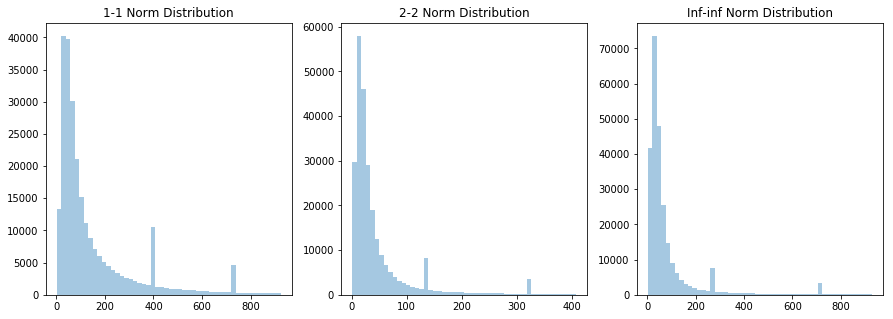

In [42]:
print(np.mean(frag_2))
print(np.median(frag_2))
print(np.std(frag_2))

plt.figure(figsize=(15,5))
plt.subplot(131)
sns.distplot(frag_1.ravel(), kde=False)
plt.title("1-1 Norm Distribution")

plt.subplot(132)
sns.distplot(frag_2.ravel(), kde=False)
plt.title("2-2 Norm Distribution")

plt.subplot(133)
sns.distplot(frag_inf.ravel(), kde=False)
plt.title("Inf-inf Norm Distribution")

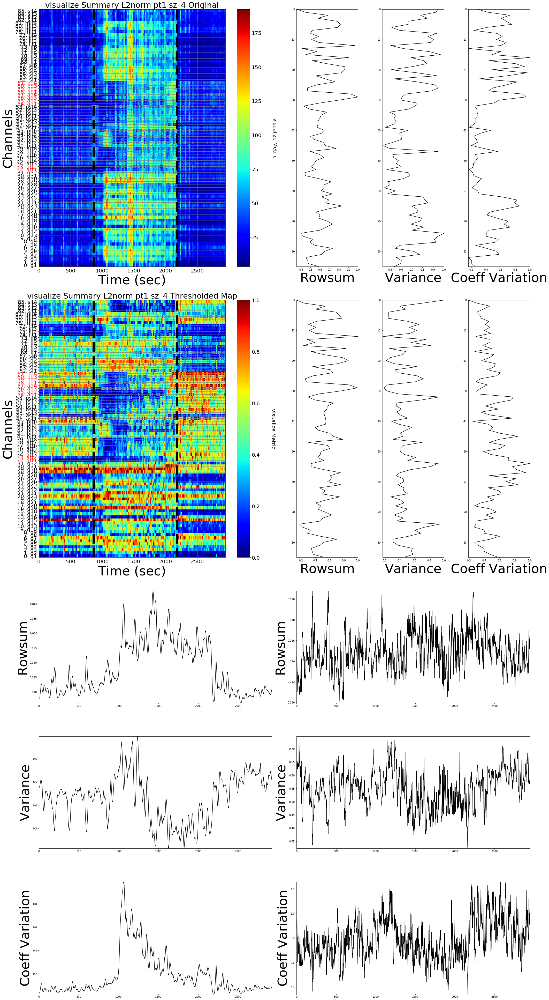

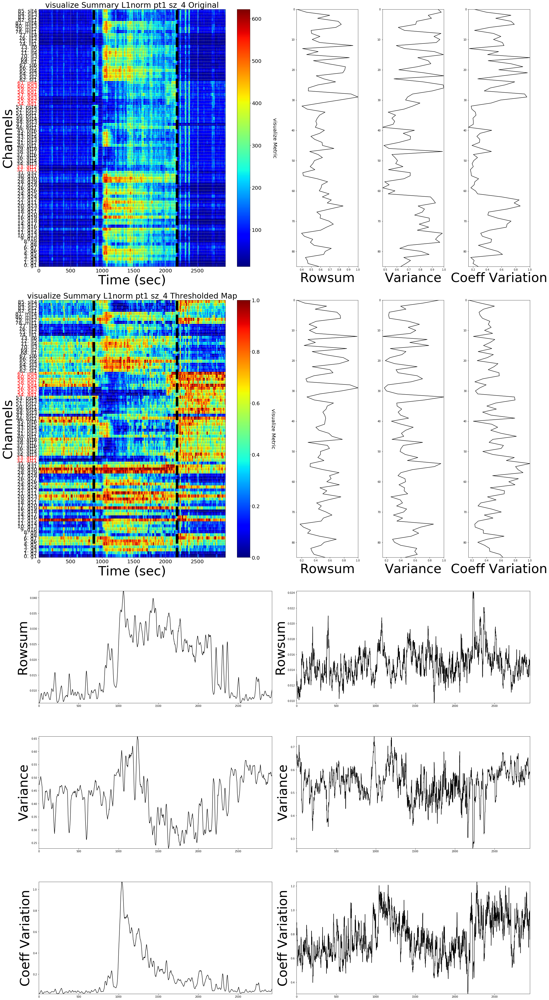

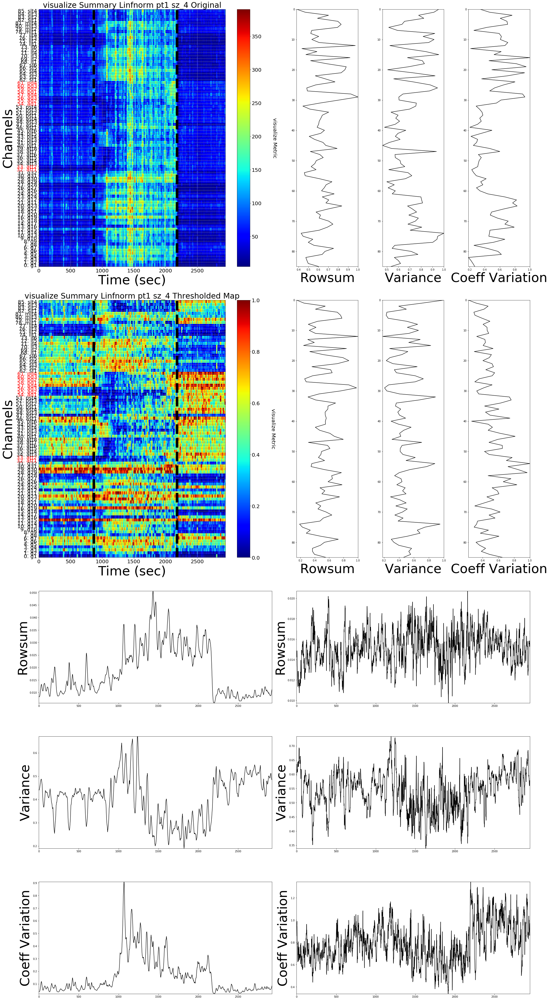

In [39]:
vertlines = [szonset, szoffset]

# plot summary plot for impulse repsonse
plotter.satellite_summary(frag_2, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary L2norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_l2_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_1, labels=chanlabels, ezcontacts=ezcontacts, 
                          vertlines=vertlines,
                      titlestr="visualize Summary L1norm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_l1_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))
plotter.satellite_summary(frag_inf, labels=chanlabels, ezcontacts=ezcontacts, vertlines=[szonset, szoffset],
                        titlestr="visualize Summary Linfnorm {} {}".
                          format(patient_id, dataset_id),
                      figure_name="netimpulse_linf_summary_satellite_plot {}_{}".
                          format(patient_id, dataset_id))

# Fragility Normalization

In [21]:
frag_inf = FragilityModel.compute_fragilitymetric(frag_inf)
frag_1 = FragilityModel.compute_fragilitymetric(frag_1)
frag_2 = FragilityModel.compute_fragilitymetric(frag_2)

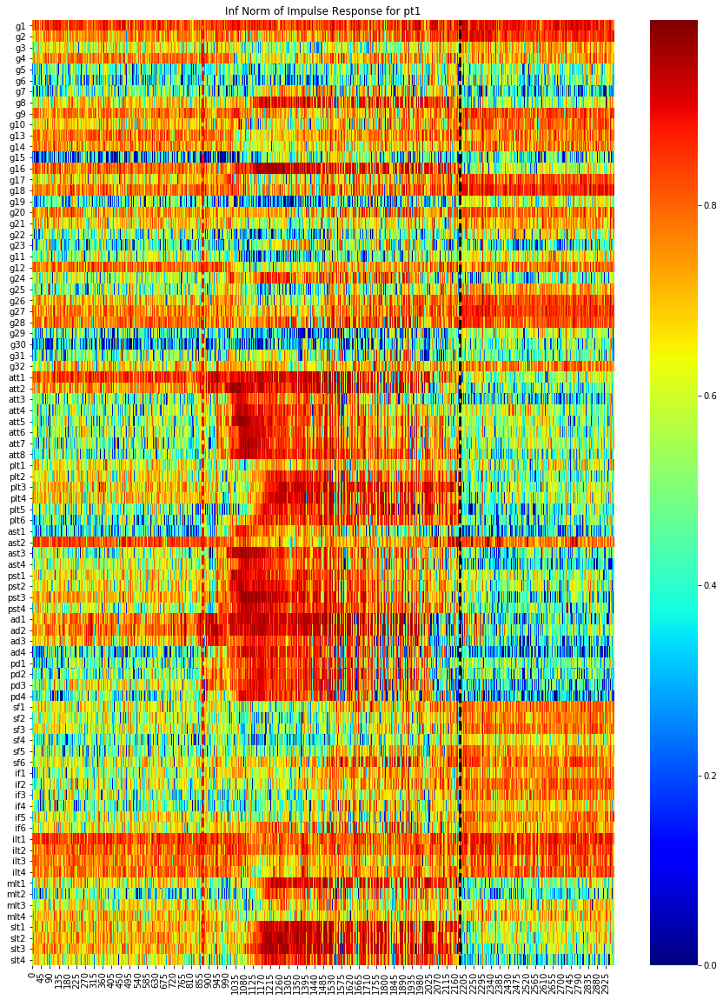

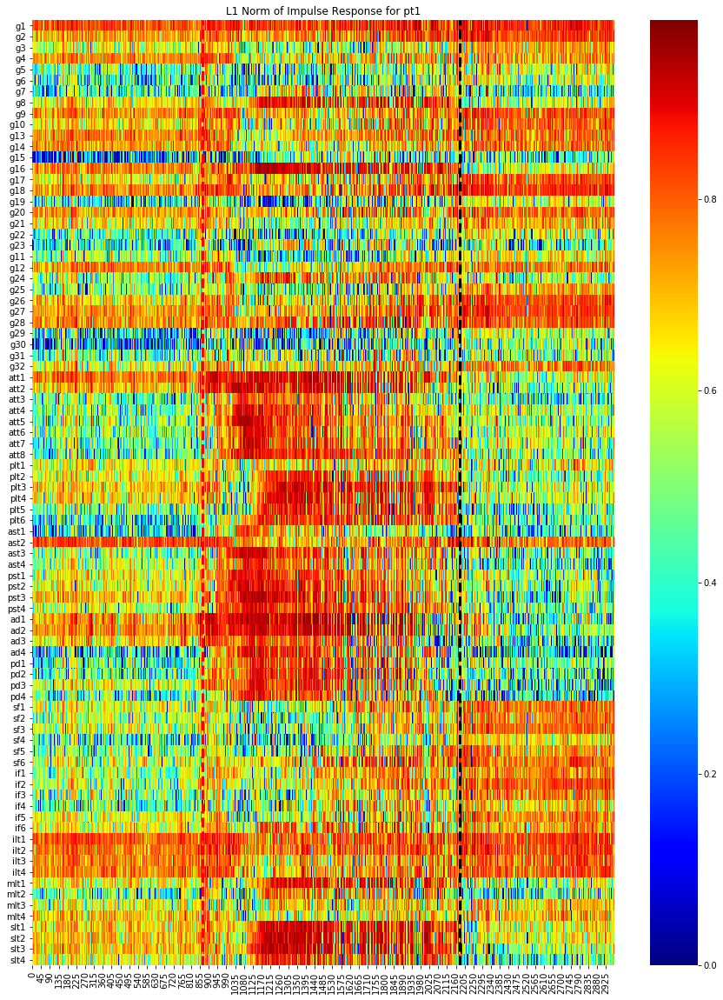

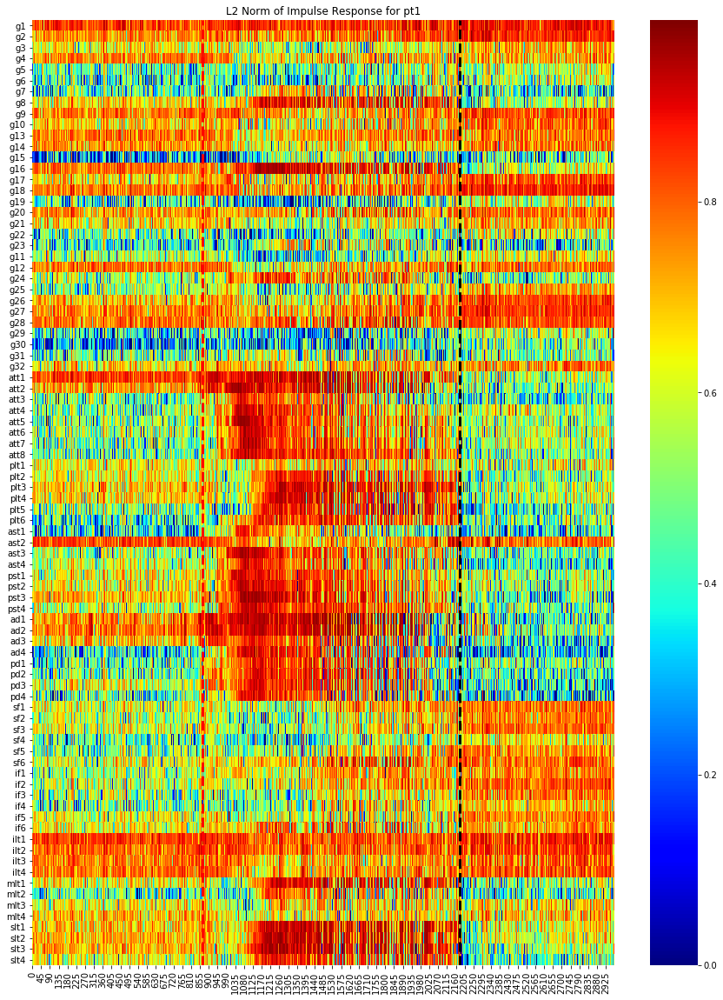

In [22]:
plt.figure(figsize=(15,20))
sns.heatmap(frag_inf, cmap='jet', yticklabels=chanlabels)
plt.title("Inf Norm of Impulse Response for {}".format(patient))
plt.axvline(szonset, linestyle='--', linewidth=3, color='red')
plt.axvline(szoffset, linestyle='--', linewidth=3, color='black')
# plt.savefig(os.path.join(figdir, "infnorm_{}_{}.png".format(patient, datasetid)))

plt.figure(figsize=(15,20))
sns.heatmap(frag_1, cmap='jet', yticklabels=chanlabels)
plt.title("L1 Norm of Impulse Response for {}".format(patient))
plt.axvline(szonset, linestyle='--', linewidth=3, color='red')
plt.axvline(szoffset, linestyle='--', linewidth=3, color='black')
# plt.savefig(os.path.join(figdir, "l1norm_{}_{}.png".format(patient, datasetid)))

plt.figure(figsize=(15,20))
sns.heatmap(frag_2, cmap='jet', yticklabels=chanlabels)
plt.title("L2 Norm of Impulse Response for {}".format(patient))
plt.axvline(szonset, linestyle='--', linewidth=3, color='red')
plt.axvline(szoffset, linestyle='--', linewidth=3, color='black')
# plt.savefig(os.path.join(figdir, "l2norm_{}_{}.png".format(patient, datasetid)))
